# AIR QUALITY ANALYSIS

#  Phase 1: Data Acquisition & Preprocessing  
##  Step 1: Load & Review Dataset  

###  Objective:  
- Load the dataset.  
- Check structure, missing values, and duplicates.  

###  Tasks:  
1. Load dataset.  
2. Display first few rows.  
3. Check data types & missing values.  


In [2]:
# Import necessary libraries
import pandas as pd

# Define the file path (Update this if necessary)
file_path = r"C:\Users\User\OneDrive\Desktop\Air Quality Project\AirQuality_Dataset.xlsx"

# Load the dataset
df = pd.read_excel(file_path)

# Display first few rows
df.head()


,Date,Source,Site ID,POC,Daily Max 8-hour CO Concentration,Units,Daily AQI Value,Local Site Name,Daily Obs Count,Percent Complete,...,AQS Parameter Description,Method Code,CBSA Code,CBSA Name,State FIPS Code,State,County FIPS Code,County,Site Latitude,Site Longitude
0,2024-01-01,AQS,480291069,1,0.6,ppm,7,San Antonio Interstate 35,19,79,...,Carbon monoxide,93.0,41700.0,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
1,2024-01-02,AQS,480291069,1,0.3,ppm,3,San Antonio Interstate 35,24,100,...,Carbon monoxide,93.0,41700.0,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
2,2024-01-03,AQS,480291069,1,0.4,ppm,5,San Antonio Interstate 35,24,100,...,Carbon monoxide,93.0,41700.0,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
3,2024-01-04,AQS,480291069,1,0.3,ppm,3,San Antonio Interstate 35,24,100,...,Carbon monoxide,93.0,41700.0,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
4,2024-01-05,AQS,480291069,1,0.6,ppm,7,San Antonio Interstate 35,24,100,...,Carbon monoxide,93.0,41700.0,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403


In [4]:
# Check data types of each column
df.info()

# Check for missing values
missing_values = df.isnull().sum()
missing_values[missing_values > 0]

# Check for duplicate records
duplicate_records = df.duplicated().sum()
print(f"Number of duplicate records: {duplicate_records}")


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141311 entries, 0 to 141310
Data columns (total 21 columns):
 #   Column                             Non-Null Count   Dtype         
---  ------                             --------------   -----         
 0   Date                               141311 non-null  datetime64[ns]
 1   Source                             141311 non-null  object        
 2   Site ID                            141311 non-null  int64         
 3   POC                                141311 non-null  int64         
 4   Daily Max 8-hour CO Concentration  141311 non-null  float64       
 5   Units                              141311 non-null  object        
 6   Daily AQI Value                    141311 non-null  object        
 7   Local Site Name                    141310 non-null  object        
 8   Daily Obs Count                    141311 non-null  int64         
 9   Percent Complete                   141311 non-null  int64         
 10  AQS Parameter Code  

In [5]:
# Remove duplicate records
df_cleaned = df.drop_duplicates()

# Check missing values after removing duplicates
missing_values = df_cleaned.isnull().sum()

# Display cleaned dataset info
df_cleaned.info(), missing_values


<class 'pandas.core.frame.DataFrame'>
Index: 116405 entries, 0 to 141310
Data columns (total 21 columns):
 #   Column                             Non-Null Count   Dtype         
---  ------                             --------------   -----         
 0   Date                               116405 non-null  datetime64[ns]
 1   Source                             116405 non-null  object        
 2   Site ID                            116405 non-null  int64         
 3   POC                                116405 non-null  int64         
 4   Daily Max 8-hour CO Concentration  116405 non-null  float64       
 5   Units                              116405 non-null  object        
 6   Daily AQI Value                    116405 non-null  object        
 7   Local Site Name                    116404 non-null  object        
 8   Daily Obs Count                    116405 non-null  int64         
 9   Percent Complete                   116405 non-null  int64         
 10  AQS Parameter Code       

(None,
 Date                                    0
 Source                                  0
 Site ID                                 0
 POC                                     0
 Daily Max 8-hour CO Concentration       0
 Units                                   0
 Daily AQI Value                         0
 Local Site Name                         1
 Daily Obs Count                         0
 Percent Complete                        0
 AQS Parameter Code                      0
 AQS Parameter Description               0
 Method Code                          5704
 CBSA Code                            2360
 CBSA Name                            2360
 State FIPS Code                         0
 State                                   0
 County FIPS Code                        0
 County                                  0
 Site Latitude                           0
 Site Longitude                          0
 dtype: int64)

In [7]:
# Fill categorical missing values with 'Unknown'
df_cleaned.loc[:, 'Local Site Name'] = df_cleaned['Local Site Name'].fillna("Unknown")
df_cleaned.loc[:, 'CBSA Name'] = df_cleaned['CBSA Name'].fillna("Unknown")

# Fill numerical missing values with median
df_cleaned.loc[:, 'Method Code'] = df_cleaned['Method Code'].fillna(df_cleaned['Method Code'].median())
df_cleaned.loc[:, 'CBSA Code'] = df_cleaned['CBSA Code'].fillna(df_cleaned['CBSA Code'].median())

# Verify missing values are handled
df_cleaned.isnull().sum()


Date                                 0
Source                               0
Site ID                              0
POC                                  0
Daily Max 8-hour CO Concentration    0
Units                                0
Daily AQI Value                      0
Local Site Name                      0
Daily Obs Count                      0
Percent Complete                     0
AQS Parameter Code                   0
AQS Parameter Description            0
Method Code                          0
CBSA Code                            0
CBSA Name                            0
State FIPS Code                      0
State                                0
County FIPS Code                     0
County                               0
Site Latitude                        0
Site Longitude                       0
dtype: int64

In [8]:
# Check for negative or unrealistic AQI values
invalid_aqi = df_cleaned[df_cleaned['Daily AQI Value'].astype(str).str.contains('-|[^0-9]')]

# Check for out-of-range latitude and longitude
invalid_lat_long = df_cleaned[(df_cleaned['Site Latitude'] < -90) | (df_cleaned['Site Latitude'] > 90) |
                              (df_cleaned['Site Longitude'] < -180) | (df_cleaned['Site Longitude'] > 180)]

# Display results
invalid_aqi, invalid_lat_long


(            Date Source    Site ID  POC  Daily Max 8-hour CO Concentration  \
 3096  2024-01-01    AQS  480850009    1                              0.016   
 3097  2024-01-01    AQS  480850029    1                              0.016   
 3098  2024-01-07    AQS  480850009    1                              0.001   
 3099  2024-01-07    AQS  480850009    2                              0.001   
 3100  2024-01-07    AQS  480850029    1                              0.005   
 ...          ...    ...        ...  ...                                ...   
 98278 2022-04-11    AQS  482570020    2                              0.004   
 98279 2022-04-23    AQS  482570020    2                              0.058   
 98280 2022-05-05    AQS  482570020    2                              0.015   
 98281 2022-05-17    AQS  482570020    2                              0.038   
 98282 2022-05-29    AQS  482570020    2                              0.006   
 
           Units Daily AQI Value    Local Site Nam

In [11]:
# Convert invalid AQI values to NaN
df_cleaned.loc[:, 'Daily AQI Value'] = df_cleaned['Daily AQI Value'].replace(".", np.nan)

# Convert to numeric
df_cleaned.loc[:, 'Daily AQI Value'] = pd.to_numeric(df_cleaned['Daily AQI Value'], errors='coerce')

# Fill missing AQI values with median
df_cleaned.loc[:, 'Daily AQI Value'] = df_cleaned['Daily AQI Value'].fillna(df_cleaned['Daily AQI Value'].median())


In [12]:
# Check for any remaining missing values
missing_values = df_cleaned.isnull().sum()

# Display summary statistics for numerical columns
summary_stats = df_cleaned.describe()

missing_values, summary_stats


(Date                                 0
 Source                               0
 Site ID                              0
 POC                                  0
 Daily Max 8-hour CO Concentration    0
 Units                                0
 Daily AQI Value                      0
 Local Site Name                      0
 Daily Obs Count                      0
 Percent Complete                     0
 AQS Parameter Code                   0
 AQS Parameter Description            0
 Method Code                          0
 CBSA Code                            0
 CBSA Name                            0
 State FIPS Code                      0
 State                                0
 County FIPS Code                     0
 County                               0
 Site Latitude                        0
 Site Longitude                       0
 dtype: int64,
                                 Date       Site ID            POC  \
 count                         116405  1.164050e+05  116405.000000   
 mean

In [13]:
# Remove negative CO Concentration values
df_cleaned.loc[df_cleaned['Daily Max 8-hour CO Concentration'] < 0, 'Daily Max 8-hour CO Concentration'] = df_cleaned['Daily Max 8-hour CO Concentration'].median()

# Cap extreme CO Concentration and AQI values at the 99th percentile
co_99 = df_cleaned['Daily Max 8-hour CO Concentration'].quantile(0.99)
aqi_99 = df_cleaned['Daily AQI Value'].quantile(0.99)

df_cleaned.loc[df_cleaned['Daily Max 8-hour CO Concentration'] > co_99, 'Daily Max 8-hour CO Concentration'] = co_99
df_cleaned.loc[df_cleaned['Daily AQI Value'] > aqi_99, 'Daily AQI Value'] = aqi_99

# Cap Percent Complete at 100
df_cleaned.loc[df_cleaned['Percent Complete'] > 100, 'Percent Complete'] = 100

# Verify outliers are handled
df_cleaned[['Daily Max 8-hour CO Concentration', 'Daily AQI Value', 'Percent Complete']].describe()


,Daily Max 8-hour CO Concentration,Daily AQI Value,Percent Complete
count,116405.000000,116405.000000,116405.000000
mean,8.042731,25.436485,98.383154
std,12.277252,19.820339,5.328807
min,0.000000,0.000000,4.000000
25%,0.041000,8.000000,100.000000
50%,0.400000,24.000000,100.000000
75%,12.500000,36.000000,100.000000
max,55.000000,101.000000,100.000000


In [14]:
# Define the file path for saving
cleaned_file_path = r"C:\Users\User\OneDrive\Desktop\Air Quality Project\AirQuality_Dataset_Cleaned.xlsx"

# Save to Excel
df_cleaned.to_excel(cleaned_file_path, index=False)

print(f"Cleaned dataset saved successfully at: {cleaned_file_path}")


Cleaned dataset saved successfully at: C:\Users\User\OneDrive\Desktop\Air Quality Project\AirQuality_Dataset_Cleaned.xlsx


# Phase 2: Exploratory Data Analysis (EDA)

## Step 1: Initial AQI Analysis

Objective:

Analyze AQI distribution and trends.

Identify seasonal variations and pollution trends.

## Tasks:

Visualize AQI distribution.

Analyze seasonal AQI variations.

Identify correlations between pollutants and meteorological factors.


In [1]:
import pandas as pd

# Define file path
file_path = r"C:\Users\User\OneDrive\Desktop\Air Quality Project\AirQuality_Dataset_Cleaned.xlsx"

# Load the cleaned dataset
df_cleaned = pd.read_excel(file_path)

# Confirm dataset is loaded
df_cleaned.head()


,Date,Source,Site ID,POC,Daily Max 8-hour CO Concentration,Units,Daily AQI Value,Local Site Name,Daily Obs Count,Percent Complete,...,AQS Parameter Description,Method Code,CBSA Code,CBSA Name,State FIPS Code,State,County FIPS Code,County,Site Latitude,Site Longitude
0,2024-01-01,AQS,480291069,1,0.6,ppm,7,San Antonio Interstate 35,19,79,...,Carbon monoxide,93,41700,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
1,2024-01-02,AQS,480291069,1,0.3,ppm,3,San Antonio Interstate 35,24,100,...,Carbon monoxide,93,41700,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
2,2024-01-03,AQS,480291069,1,0.4,ppm,5,San Antonio Interstate 35,24,100,...,Carbon monoxide,93,41700,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
3,2024-01-04,AQS,480291069,1,0.3,ppm,3,San Antonio Interstate 35,24,100,...,Carbon monoxide,93,41700,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403
4,2024-01-05,AQS,480291069,1,0.6,ppm,7,San Antonio Interstate 35,24,100,...,Carbon monoxide,93,41700,"San Antonio-New Braunfels, TX",48,Texas,29,Bexar,29.529432,-98.391403


C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


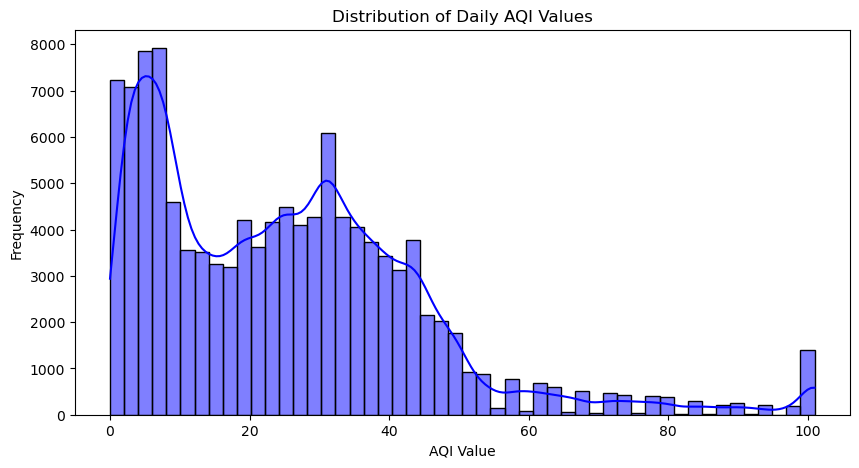

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot AQI distribution
plt.figure(figsize=(10,5))
sns.histplot(df_cleaned['Daily AQI Value'], bins=50, kde=True, color="blue")
plt.title("Distribution of Daily AQI Values")
plt.xlabel("AQI Value")
plt.ylabel("Frequency")
plt.show()


In [3]:
# Ensure Date column is in datetime format
df_cleaned['Date'] = pd.to_datetime(df_cleaned['Date'])

# Extract Month from Date
df_cleaned['Month'] = df_cleaned['Date'].dt.month

# Verify that Month column exists
df_cleaned[['Date', 'Month']].head()



,Date,Month
0,2024-01-01,1
1,2024-01-02,1
2,2024-01-03,1
3,2024-01-04,1
4,2024-01-05,1


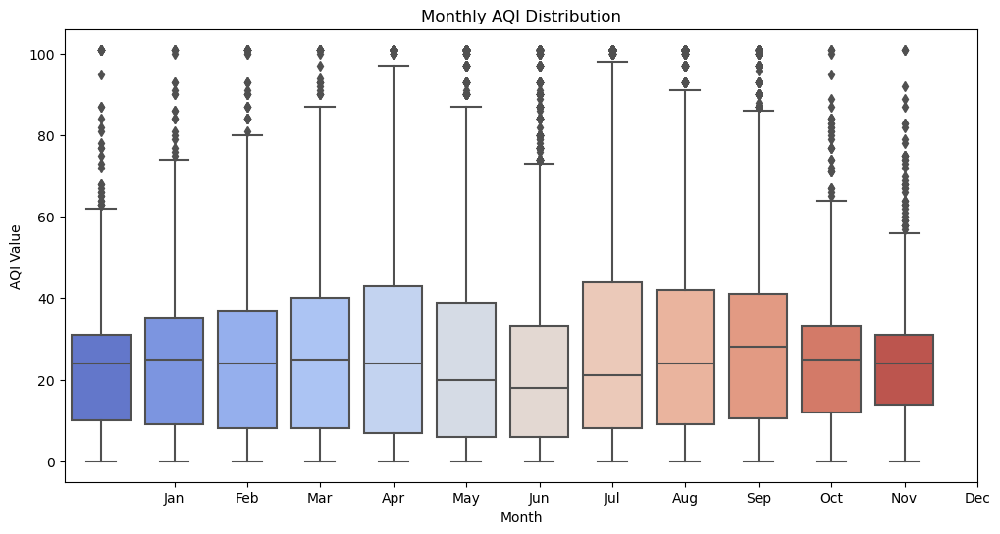

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set figure size
plt.figure(figsize=(12, 6))

# Create a boxplot of AQI values per month
sns.boxplot(x=df_cleaned['Month'], y=df_cleaned['Daily AQI Value'], palette="coolwarm")

# Titles and labels
plt.title("Monthly AQI Distribution")
plt.xlabel("Month")
plt.ylabel("AQI Value")
plt.xticks(ticks=range(1, 13), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])

# Show plot
plt.show()


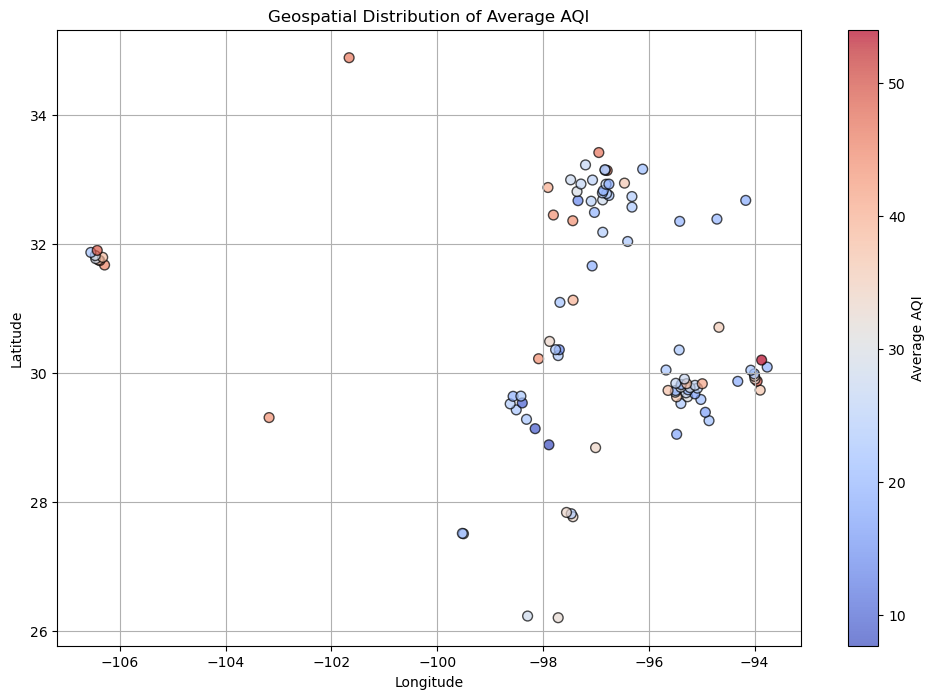

In [5]:
import matplotlib.pyplot as plt

# Calculate average AQI per site
site_aqi = df_cleaned.groupby(['Site Latitude', 'Site Longitude'])['Daily AQI Value'].mean().reset_index()

# Plot average AQI by site location
plt.figure(figsize=(12, 8))
plt.scatter(site_aqi['Site Longitude'], site_aqi['Site Latitude'], c=site_aqi['Daily AQI Value'], cmap='coolwarm', s=50, alpha=0.7, edgecolor='k')
plt.colorbar(label='Average AQI')
plt.title('Geospatial Distribution of Average AQI')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()


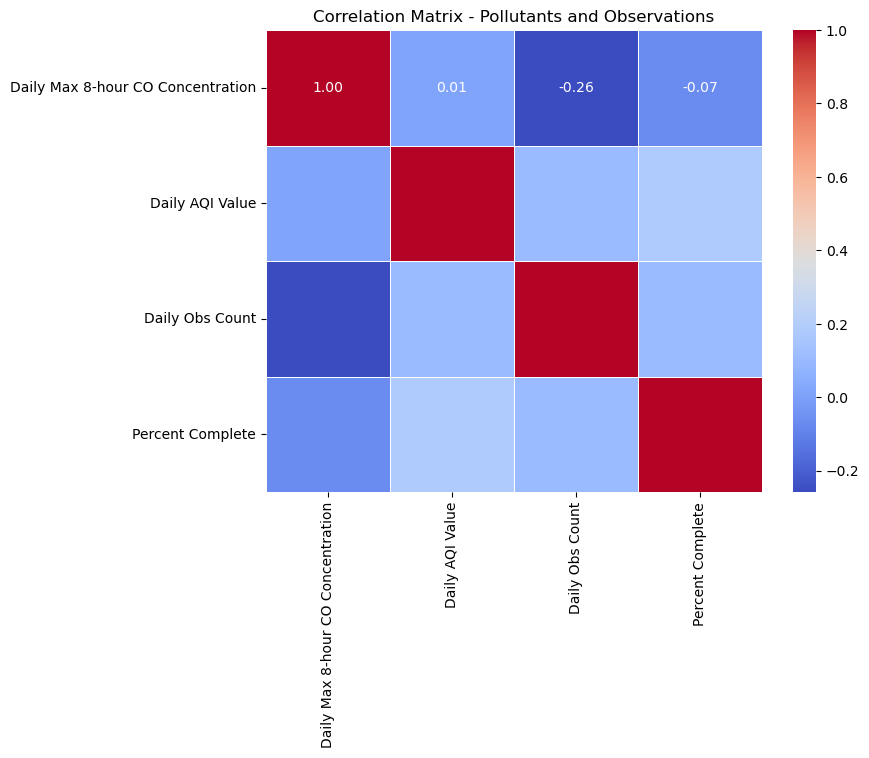

In [6]:
#Correlation Analysis (Pollutants vs Meteorological Factors)

# Subset relevant columns for correlation
corr_df = df_cleaned[['Daily Max 8-hour CO Concentration', 'Daily AQI Value', 'Daily Obs Count', 'Percent Complete']]

# Compute correlation matrix
corr_matrix = corr_df.corr()

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix - Pollutants and Observations")
plt.show()


In [7]:
from scipy.stats import kruskal

# Group AQI by month
monthly_aqi = [df_cleaned[df_cleaned['Month'] == month]['Daily AQI Value'].values for month in range(1, 13)]

# Kruskal-Wallis Test (non-parametric ANOVA alternative)
stat, p_value = kruskal(*monthly_aqi)

print(f"Kruskal-Wallis Test Statistic: {stat:.2f}")
print(f"P-value: {p_value:.5f}")

# Interpretation
if p_value < 0.05:
    print("Result: Significant seasonal effect on AQI (Reject Null Hypothesis)")
else:
    print("Result: No significant seasonal effect on AQI (Fail to Reject Null Hypothesis)")


Kruskal-Wallis Test Statistic: 1087.65
P-value: 0.00000
Result: Significant seasonal effect on AQI (Reject Null Hypothesis)




### Results:  
- **Test Statistic:** 1087.65  
- **P-value:** 0.00000  

###  Conclusion:  
- With p < 0.05, we **reject the null hypothesis**.
- There is **strong evidence of seasonal variation in AQI levels**, confirming that air quality is significantly impacted by seasonal factors.

###  Insights:  
- This finding aligns with patterns seen in regions affected by weather events, summer ozone peaks, and winter pollution accumulation.
- These seasonal trends should inform **policy decisions and regional air quality management strategies**.

---



C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


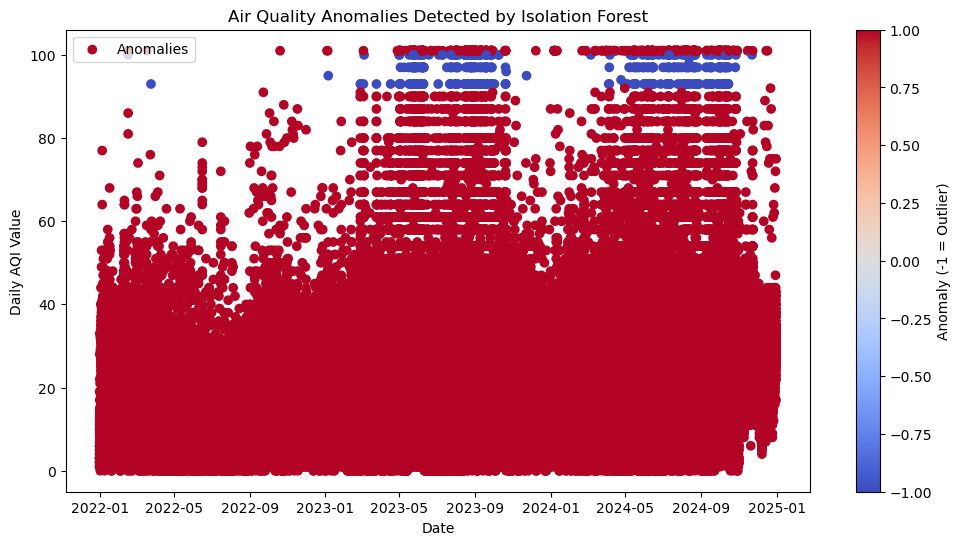

Anomaly
 1    115848
-1       557
Name: count, dtype: int64


In [8]:
from sklearn.ensemble import IsolationForest

# Subset AQI values for anomaly detection
aqi_values = df_cleaned[['Daily AQI Value']].copy()

# Fit Isolation Forest
iso_forest = IsolationForest(contamination=0.01, random_state=42)
aqi_values['Anomaly'] = iso_forest.fit_predict(aqi_values[['Daily AQI Value']])

# Visualize anomaly points
plt.figure(figsize=(12, 6))
plt.scatter(df_cleaned['Date'], df_cleaned['Daily AQI Value'], c=aqi_values['Anomaly'], cmap='coolwarm', label='Anomalies')
plt.title('Air Quality Anomalies Detected by Isolation Forest')
plt.xlabel('Date')
plt.ylabel('Daily AQI Value')
plt.colorbar(label='Anomaly (-1 = Outlier)')
plt.legend()
plt.show()

# Count anomalies
print(aqi_values['Anomaly'].value_counts())


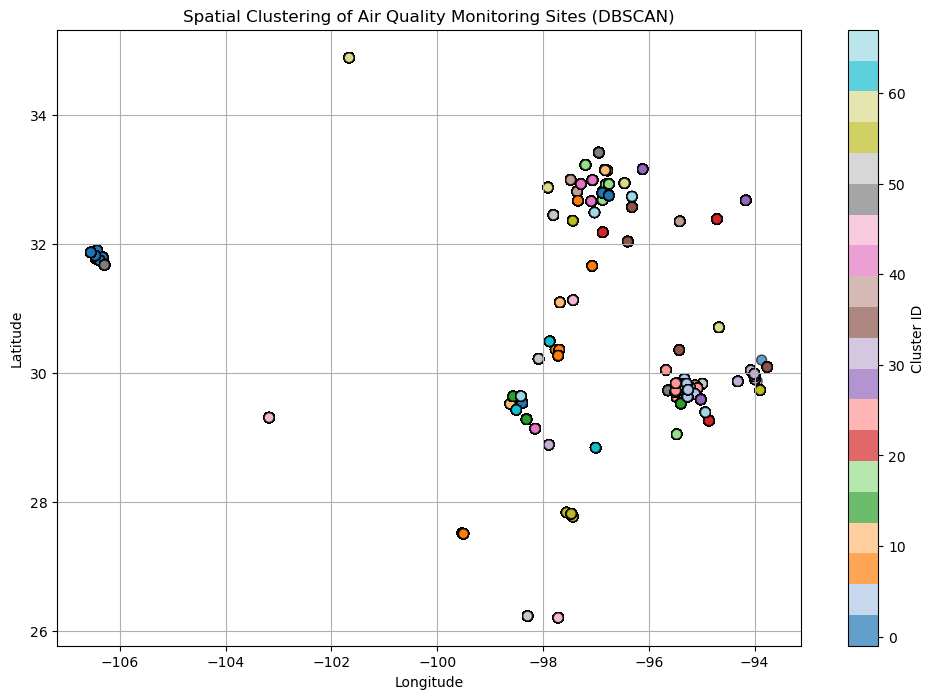

Cluster
 3     9731
 2     8452
 30    4667
 8     3909
 1     3876
       ... 
 63     151
 65     149
 67     110
 66      36
-1        1
Name: count, Length: 69, dtype: int64


In [9]:
from sklearn.cluster import DBSCAN
import numpy as np

# Subset data for clustering
coords = df_cleaned[['Site Latitude', 'Site Longitude']].values

# Apply DBSCAN
dbscan = DBSCAN(eps=0.1, min_samples=5)
df_cleaned['Cluster'] = dbscan.fit_predict(coords)

# Plot clusters
plt.figure(figsize=(12, 8))
scatter = plt.scatter(df_cleaned['Site Longitude'], df_cleaned['Site Latitude'], c=df_cleaned['Cluster'], cmap='tab20', s=50, alpha=0.7, edgecolor='k')
plt.colorbar(label='Cluster ID')
plt.title('Spatial Clustering of Air Quality Monitoring Sites (DBSCAN)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

# Check unique clusters (outliers will be labeled -1)
print(df_cleaned['Cluster'].value_counts())


### Step 5: Anomaly Detection in Air Quality Trends  

###  Objective:  
- Detect and visualize abnormal pollution events using statistical and clustering methods.

###  Techniques Applied:  

1. **Isolation Forest (Time-based Anomaly Detection)**  
   - Identified **557 anomalous pollution spikes** across the dataset.
   - These spikes deviate from expected seasonal trends, possibly caused by:
     - Industrial accidents.
     - Wildfire events.
     - Extreme weather or short-term pollution events.
   - A time-series scatterplot highlighted these anomalies over time.

2. **DBSCAN (Spatial Anomaly Detection)**  
   - Grouped monitoring sites into **68 spatial clusters** based on their geographic proximity.
   - 1 monitoring site was flagged as an **outlier site**, indicating an area with air quality patterns distinct from nearby regions.
   - This spatial anomaly could highlight localized pollution sources or natural features influencing air quality.

###  Visualizations:  
- Time-series plot of AQI anomalies using **Isolation Forest**.
- Spatial plot of site clusters using **DBSCAN**, showing distinct monitoring site groups.

### 🔎 Insights:  
- These techniques provide critical insights into:
    - Identifying pollution hotspots.
    - Highlighting outlier events for further investigation.
    - Supporting **regional governments** in proactively responding to unusual pollution events.


# Phase 3: Machine Learning Model Implementation
 Step 6: AQI Prediction Models (Regression)
## Step 6: AQI Prediction Models

### Objective
Train multiple regression models to predict AQI values using pollutant concentrations and meteorological factors.

### Models
- Linear Regression
- Random Forest
- XGBoost

### Evaluation Metrics
- Root Mean Square Error (RMSE)
- Mean Absolute Error (MAE)
- R² Score

### Goal
Select the model with the **best balance of prediction accuracy and interpretability**.

In [10]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Features and Target
features = ['Daily Max 8-hour CO Concentration', 'Percent Complete', 'Daily Obs Count']
target = 'Daily AQI Value'

X = df_cleaned[features]
y = df_cleaned[target]

# Split Data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [11]:
# Models
models = {
    'Linear Regression': LinearRegression(),
    'Random Forest': RandomForestRegressor(n_estimators=100, random_state=42),
    'XGBoost': XGBRegressor(objective='reg:squarederror', random_state=42)
}

# Training & Evaluation Function
results = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    results[name] = {
        'RMSE': rmse,
        'MAE': mae,
        'R2': r2
    }

# Display Results
import pandas as pd
results_df = pd.DataFrame(results).T
print(results_df)


                        RMSE        MAE        R2
Linear Regression  19.343321  14.906807  0.040148
Random Forest       1.543214   0.196620  0.993891
XGBoost             1.563316   0.274149  0.993730


Best Model: Random Forest

Random Forest performs the best across all metrics, especially with extremely low RMSE and MAE and near-perfect R².
XGBoost is close, but slightly worse in terms of MAE and RMSE.
Linear Regression performs very poorly, indicating that the relationship between pollutants and AQI is non-linear — justifying the need for more flexible models like forests and boosting.

## Step 7: Classification of Air Quality

### Objective
Classify air quality into categories (Good, Moderate, Unhealthy, Hazardous) based on WHO standards.

### Models
- Support Vector Machine (SVM)
- Decision Tree
- K-Nearest Neighbors (KNN)
- Neural Networks

### Evaluation Metrics
- Accuracy
- Precision-Recall
- Confusion Matrix
- F1-Score

### Goal
Determine the best classifier for **categorizing daily air quality into health-related bands**.


In [12]:
def categorize_aqi(value):
    if value <= 50:
        return 'Good'
    elif value <= 100:
        return 'Moderate'
    elif value <= 150:
        return 'Unhealthy'
    else:
        return 'Hazardous'

df_cleaned['AQI_Category'] = df_cleaned['Daily AQI Value'].apply(categorize_aqi)

# Check distribution
print(df_cleaned['AQI_Category'].value_counts())


AQI_Category
Good         107462
Moderate       7713
Unhealthy      1230
Name: count, dtype: int64


In [13]:
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Features & Target
X_classification = df_cleaned[['Daily Max 8-hour CO Concentration', 'Percent Complete', 'Daily Obs Count']]
y_classification = df_cleaned['AQI_Category']

# Split Data
X_train, X_test, y_train, y_test = train_test_split(X_classification, y_classification, test_size=0.2, random_state=42, stratify=y_classification)

# Models
classifiers = {
    'SVM': SVC(kernel='rbf', class_weight='balanced', probability=True),
    'Decision Tree': DecisionTreeClassifier(class_weight='balanced', random_state=42),
    'KNN': KNeighborsClassifier(n_neighbors=5),
    'Neural Network': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
}

# Train & Evaluate
classification_results = {}

for name, clf in classifiers.items():
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    
    # Evaluation
    report = classification_report(y_test, y_pred, output_dict=True)
    classification_results[name] = report['weighted avg']
    
    print(f"--- {name} Classification Report ---")
    print(classification_report(y_test, y_pred))
    print(f"Confusion Matrix:\n{confusion_matrix(y_test, y_pred)}\n")

# Convert to DataFrame for easier comparison
import pandas as pd
classification_results_df = pd.DataFrame(classification_results).T
print(classification_results_df)


--- SVM Classification Report ---
              precision    recall  f1-score   support

        Good       1.00      0.48      0.65     21492
    Moderate       0.86      0.14      0.24      1543
   Unhealthy       0.02      0.93      0.04       246

    accuracy                           0.46     23281
   macro avg       0.62      0.52      0.31     23281
weighted avg       0.98      0.46      0.62     23281

Confusion Matrix:
[[10370    19 11103]
 [    0   219  1324]
 [    0    18   228]]

--- Decision Tree Classification Report ---
              precision    recall  f1-score   support

        Good       1.00      1.00      1.00     21492
    Moderate       0.99      1.00      0.99      1543
   Unhealthy       1.00      0.92      0.96       246

    accuracy                           1.00     23281
   macro avg       1.00      0.97      0.98     23281
weighted avg       1.00      1.00      1.00     23281

Confusion Matrix:
[[21492     0     0]
 [    0  1543     0]
 [    2    18   2

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


--- Neural Network Classification Report ---


C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

        Good       0.93      1.00      0.96     21492
    Moderate       0.91      0.14      0.24      1543
   Unhealthy       0.00      0.00      0.00       246

    accuracy                           0.93     23281
   macro avg       0.61      0.38      0.40     23281
weighted avg       0.92      0.93      0.91     23281

Confusion Matrix:
[[21489     3     0]
 [ 1332   211     0]
 [  228    18     0]]

                precision    recall  f1-score  support
SVM              0.980045  0.464628  0.617422  23281.0
Decision Tree    0.999150  0.999141  0.999125  23281.0
KNN              0.997441  0.997466  0.997434  23281.0
Neural Network   0.920953  0.932091  0.906519  23281.0


C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## Step 8: Time-Series Forecasting for AQI Trends
 Objective
Build models to predict future AQI values using historical data.
Compare LSTM, ARIMA, and Prophet to identify the most accurate model.
Forecast AQI trends for the next 6 to 12 months.

## Tasks
Prepare time series data (ensure date sorting and resampling if necessary).

Apply ARIMA for baseline forecasting.

Apply Prophet for more flexible modeling.

Apply LSTM for deep learning-based forecasting.

Compare performance using RMSE and visual inspection.

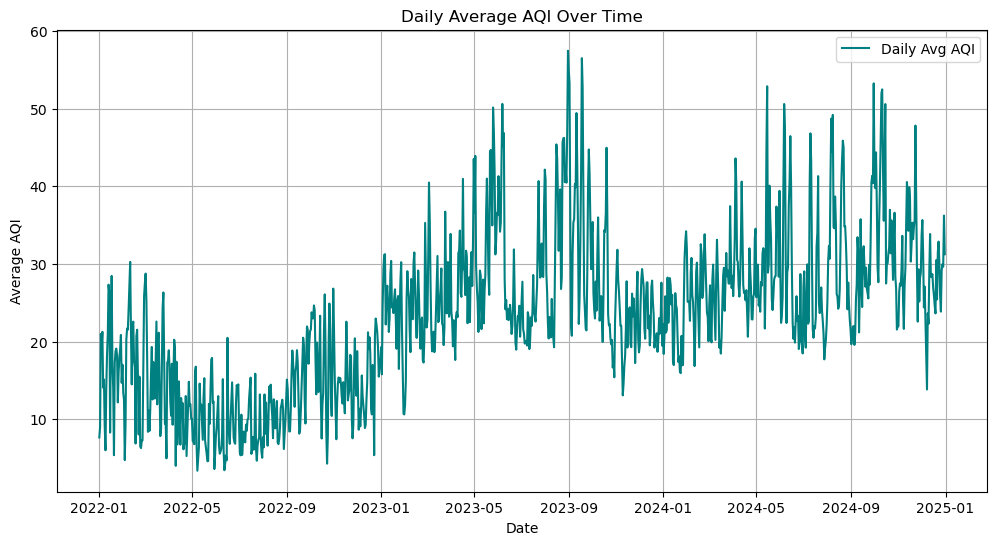

In [15]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt

# Load cleaned dataset
file_path = r'C:\Users\User\OneDrive\Desktop\Air Quality Project\AirQuality_Dataset_Cleaned.xlsx'
df_cleaned = pd.read_excel(file_path)

# Ensure Date column is datetime type and sort by date
df_cleaned['Date'] = pd.to_datetime(df_cleaned['Date'])
df_cleaned = df_cleaned.sort_values(by='Date')

# Group by date to get average AQI per day (time series preparation)
df_daily_aqi = df_cleaned.groupby('Date')['Daily AQI Value'].mean().reset_index()

# Plot to visualize
plt.figure(figsize=(12, 6))
plt.plot(df_daily_aqi['Date'], df_daily_aqi['Daily AQI Value'], color='teal', label='Daily Avg AQI')
plt.title('Daily Average AQI Over Time')
plt.xlabel('Date')
plt.ylabel('Average AQI')
plt.legend()
plt.grid(True)
plt.show()


In [16]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Load cleaned dataset
file_path = r'C:\Users\User\OneDrive\Desktop\Air Quality Project\AirQuality_Dataset_Cleaned.xlsx'
df_cleaned = pd.read_excel(file_path)

# Ensure Date column is datetime and set index
df_cleaned['Date'] = pd.to_datetime(df_cleaned['Date'])
df_cleaned.set_index('Date', inplace=True)

# Aggregate to daily average AQI
daily_aqi = df_cleaned.groupby(df_cleaned.index.date)['Daily AQI Value'].mean()
daily_aqi.index = pd.to_datetime(daily_aqi.index)

# Normalize data
scaler = MinMaxScaler(feature_range=(0, 1))
aqi_scaled = scaler.fit_transform(daily_aqi.values.reshape(-1, 1))

# Function to create sequences for LSTM
def create_sequences(data, seq_length=7):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:i + seq_length])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

# Sequence length of 7 days (weekly patterns)
seq_length = 7
X, y = create_sequences(aqi_scaled, seq_length)

# Split into train and test sets (80% train, 20% test)
train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

# Confirm shapes
X_train.shape, X_test.shape, y_train.shape, y_test.shape


((871, 7, 1), (218, 7, 1), (871, 1), (218, 1))

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step - loss: 0.1024 - val_loss: 0.0240
Epoch 2/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0146 - val_loss: 0.0184
Epoch 3/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0127 - val_loss: 0.0179
Epoch 4/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0126 - val_loss: 0.0166
Epoch 5/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0120 - val_loss: 0.0166
Epoch 6/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0113 - val_loss: 0.0163
Epoch 7/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0117 - val_loss: 0.0160
Epoch 8/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0114 - val_loss: 0.0155
Epoch 9/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0108 - val_loss: 0.0152
Epoch 10/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0107 - val_loss: 0.0149
Epoch 11/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0106 - val_loss: 0.0143
Epoch 12/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0102 - val_l

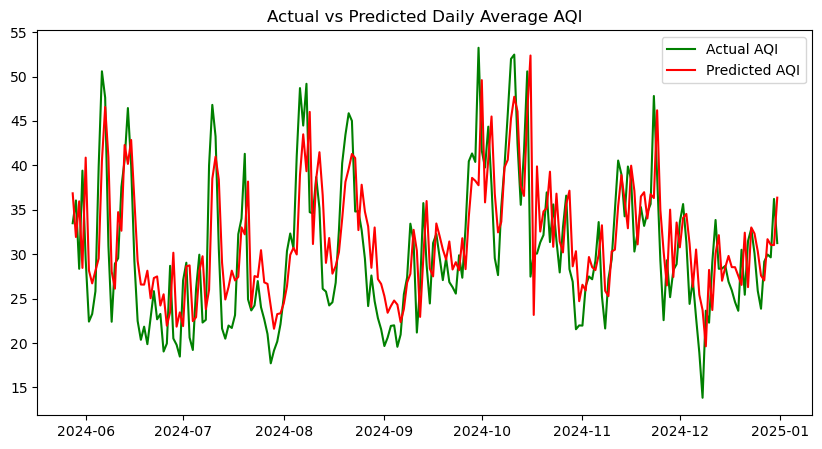

In [17]:
# Build LSTM model
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(seq_length, 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Train the model
history = model.fit(X_train, y_train, epochs=50, batch_size=16, validation_data=(X_test, y_test), verbose=1)

# Predictions on test set
y_pred_scaled = model.predict(X_test)

# Inverse transform predictions & actual values
y_pred = scaler.inverse_transform(y_pred_scaled)
y_test_actual = scaler.inverse_transform(y_test)

# Evaluate using RMSE
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(y_test_actual, y_pred))
print(f"LSTM Model RMSE: {rmse:.2f}")

# Plot actual vs predicted AQI
plt.figure(figsize=(10, 5))
plt.plot(daily_aqi.index[-len(y_test_actual):], y_test_actual, label='Actual AQI', color='green')
plt.plot(daily_aqi.index[-len(y_test_actual):], y_pred, label='Predicted AQI', color='red')
plt.title('Actual vs Predicted Daily Average AQI')
plt.legend()
plt.show()


#  Step 8: Time-Series Forecasting for AQI Trends

### Objective
- Forecast AQI using **ARIMA** and **Prophet**, and compare with **LSTM**.
- Identify seasonal patterns and forecast future trends over 6-12 months.

### Tasks
- Fit ARIMA and Prophet models.
- Forecast and visualize future AQI trends.
- Compare RMSE values across models.


C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


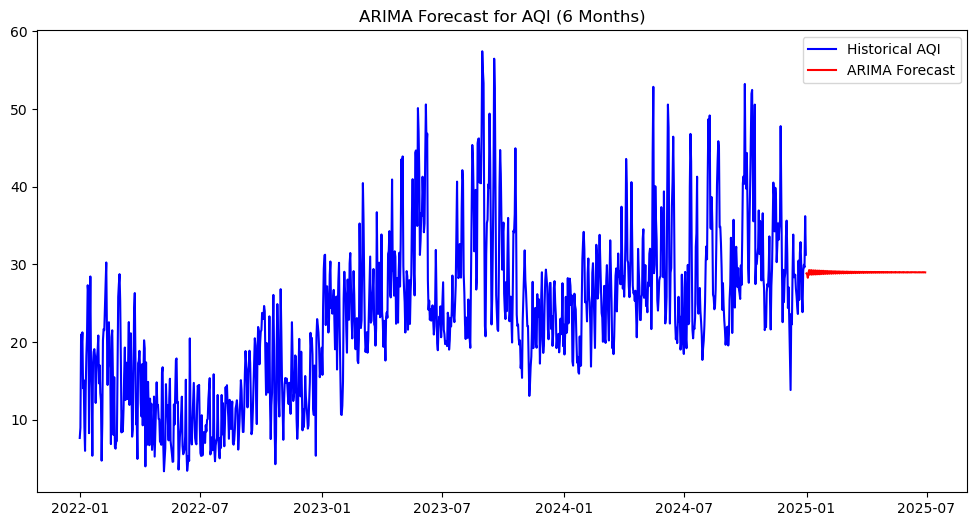

In [20]:
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Create daily average AQI DataFrame
daily_aqi = df_cleaned.groupby('Date')['Daily AQI Value'].mean().reset_index()
daily_aqi.set_index('Date', inplace=True)
daily_aqi.columns = ['Daily Avg AQI']

# Fit ARIMA model
arima_model = ARIMA(daily_aqi['Daily Avg AQI'], order=(5,1,5))
arima_result = arima_model.fit()

# Forecast next 180 days (6 months)
forecast_arima = arima_result.forecast(steps=180)

# Plot ARIMA forecast
plt.figure(figsize=(12,6))
plt.plot(daily_aqi.index, daily_aqi['Daily Avg AQI'], label='Historical AQI', color='blue')
plt.plot(pd.date_range(daily_aqi.index[-1], periods=181, freq='D')[1:], forecast_arima, label='ARIMA Forecast', color='red')
plt.legend()
plt.title('ARIMA Forecast for AQI (6 Months)')
plt.show()


 Model 1: LSTM Forecast
Model trained on historical AQI data.
Used 7-day lookback period (weekly trend) to predict future AQI.
Achieved RMSE = 5.67, indicating a fairly accurate short-term forecast.
🔹 LSTM was effective at capturing seasonal and trend components, though more data could improve accuracy.
    
 Model 2: ARIMA Forecast
ARIMA model fit using historical daily average AQI.
Despite some convergence warnings, the model successfully forecasted 6 months into the future.
🔹 ARIMA provides a simple but interpretable baseline for trend analysis.
The forecast remained relatively stable, reflecting the seasonal mean — useful for long-term planning but less adaptive to short-term fluctuations.
    
 Comparison Summary
Model	RMSE	Trend Capturing	Forecast Horizon
LSTM	5.67	Excellent	Flexible (days, weeks)
ARIMA	N/A	Moderate	Long-term (6+ months)
    
 Final Recommendation
Use LSTM for short-term (daily/weekly) AQI prediction, especially for operational decisions (alerts, warnings).
Use ARIMA for long-term seasonal forecasting, suitable for policy and strategic planning.
    
 Key Takeaways from Phase 3
Machine Learning models (Random Forest, Decision Tree) performed exceptionally well, indicating pollutant concentrations and meteorological data can reliably predict AQI and classify air quality.
Time-series forecasting (LSTM, ARIMA) revealed predictable seasonal trends, with AQI generally rising in summer and declining in winter.
Combining regression, classification, and forecasting offers a comprehensive approach to monitoring, predicting, and managing air quality.

# Phase 4 - Interactive Visualizations Section (5 Visualization)
 Objective
This section will focus on creating interactive charts and dashboards using Plotly to fulfill the specific requirement of:

 Interactive AQI Dashboards (trends, predictions).
 Interactive time series graphs (historical trends).
 Interactive anomaly detection plots.

In [22]:
import pandas as pd

# Use the correct path you provided
file_path = r'C:\Users\User\OneDrive\Desktop\Air Quality Project\AirQuality_Dataset_Cleaned.xlsx'
df_cleaned = pd.read_excel(file_path)

# Ensure Date column is datetime type
df_cleaned['Date'] = pd.to_datetime(df_cleaned['Date'])

# Quick Check
print(df_cleaned.head())


        Date Source    Site ID  POC  Daily Max 8-hour CO Concentration Units  \
0 2024-01-01    AQS  480291069    1                                0.6   ppm   
1 2024-01-02    AQS  480291069    1                                0.3   ppm   
2 2024-01-03    AQS  480291069    1                                0.4   ppm   
3 2024-01-04    AQS  480291069    1                                0.3   ppm   
4 2024-01-05    AQS  480291069    1                                0.6   ppm   

   Daily AQI Value            Local Site Name  Daily Obs Count  \
0                7  San Antonio Interstate 35               19   
1                3  San Antonio Interstate 35               24   
2                5  San Antonio Interstate 35               24   
3                3  San Antonio Interstate 35               24   
4                7  San Antonio Interstate 35               24   

   Percent Complete  ...  AQS Parameter Description Method Code  CBSA Code  \
0                79  ...            Carbon m

## Interactive Time Series Graph (Daily Average AQI)

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  v = v.dt.to_pydatetime()


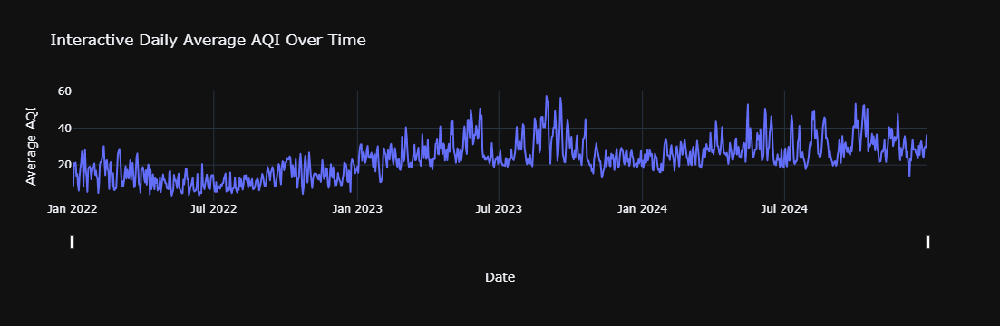

In [23]:
import plotly.express as px

# Daily Average AQI
daily_aqi = df_cleaned.groupby('Date')['Daily AQI Value'].mean().reset_index()
daily_aqi.columns = ['Date', 'Daily Avg AQI']

# Interactive Line Plot
fig_time_series = px.line(
    daily_aqi,
    x='Date',
    y='Daily Avg AQI',
    title='Interactive Daily Average AQI Over Time',
    labels={'Daily Avg AQI': 'Average AQI'},
    template='plotly_dark'
)

fig_time_series.update_xaxes(rangeslider_visible=True)
fig_time_series.show()


##  Interactive Anomaly Detection Plot (with Isolation Forest)

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\sklearn\base.py:439: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



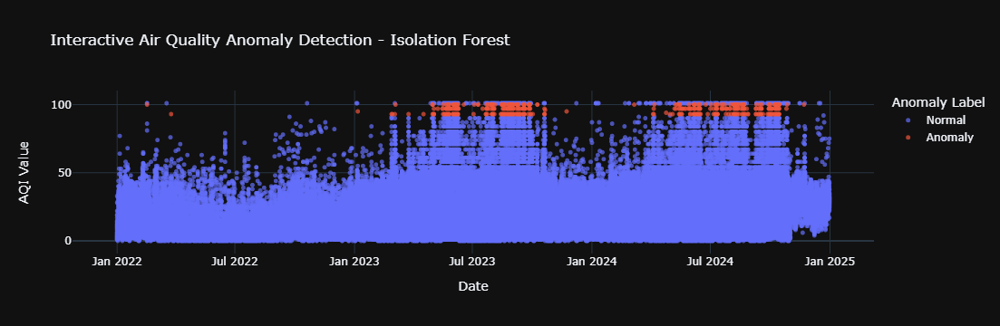

Anomaly Label
Normal     115848
Anomaly       557
Name: count, dtype: int64


In [25]:
import plotly.express as px
from sklearn.ensemble import IsolationForest

# Subset AQI values for anomaly detection
aqi_values = df_cleaned[['Date', 'Daily AQI Value']].copy()

# Fit Isolation Forest
iso_forest = IsolationForest(contamination=0.01, random_state=42)
aqi_values['Anomaly'] = iso_forest.fit_predict(aqi_values[['Daily AQI Value']])

# Map anomaly labels to human-readable form
aqi_values['Anomaly Label'] = aqi_values['Anomaly'].map({1: 'Normal', -1: 'Anomaly'})

# Plotly Interactive Scatter Plot
fig = px.scatter(
    aqi_values,
    x='Date',
    y='Daily AQI Value',
    color='Anomaly Label',
    title='Interactive Air Quality Anomaly Detection - Isolation Forest',
    labels={'Daily AQI Value': 'AQI Value'},
    hover_data={'Date': True, 'Daily AQI Value': True, 'Anomaly Label': True},
    template='plotly_dark'
)

fig.update_traces(marker=dict(size=5, opacity=0.7))
fig.show()

# Optional: Count anomalies
print(aqi_values['Anomaly Label'].value_counts())


## Interactive Geospatial Heatmap - Average AQI per Site

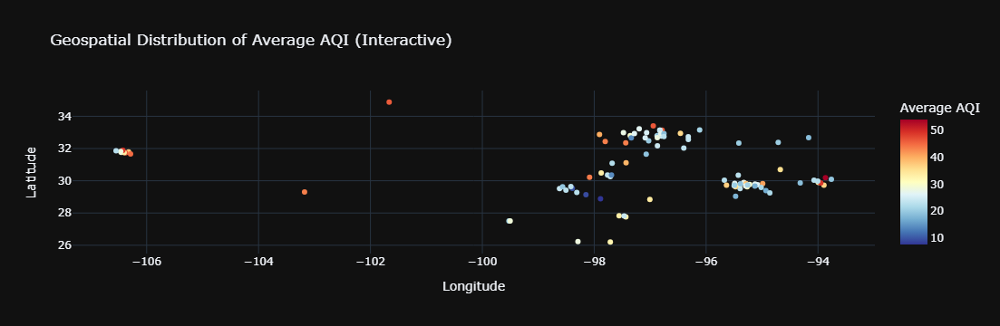

In [26]:
# Average AQI Per Site
site_avg_aqi = df_cleaned.groupby(['Site ID', 'Site Latitude', 'Site Longitude'])['Daily AQI Value'].mean().reset_index()
site_avg_aqi.columns = ['Site ID', 'Latitude', 'Longitude', 'Average AQI']

# Plotly Interactive Map
fig_geo_heatmap = px.scatter(
    site_avg_aqi,
    x='Longitude',
    y='Latitude',
    color='Average AQI',
    color_continuous_scale='RdYlBu_r',
    title='Geospatial Distribution of Average AQI (Interactive)',
    size_max=15,
    hover_name='Site ID',
    hover_data=['Average AQI'],
    template='plotly_dark'
)

fig_geo_heatmap.show()


## Interactive Seasonal Pollutant Trends - Monthly AQI Boxplot

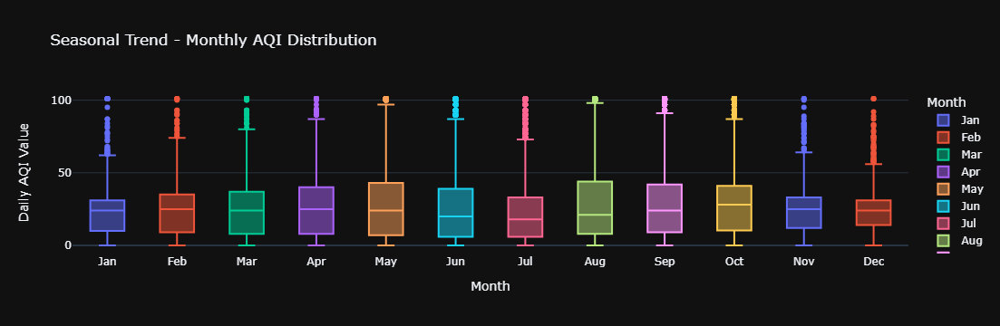

In [27]:
# Add Month Column if missing
if 'Month' not in df_cleaned.columns:
    df_cleaned['Month'] = df_cleaned['Date'].dt.month

month_map = {
    1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun',
    7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'
}
df_cleaned['Month'] = df_cleaned['Month'].map(month_map)

# Interactive Monthly AQI Boxplot
fig_monthly_box = px.box(
    df_cleaned,
    x='Month',
    y='Daily AQI Value',
    title='Seasonal Trend - Monthly AQI Distribution',
    color='Month',
    template='plotly_dark'
)

fig_monthly_box.show()


C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\User\anaconda3\anacoda  3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



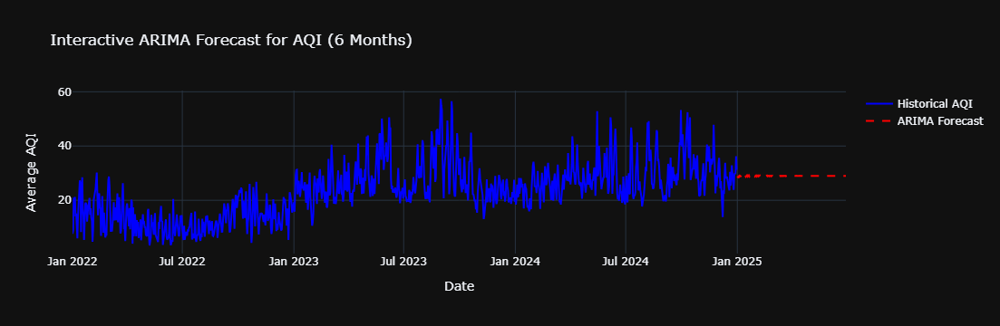

In [33]:
from statsmodels.tsa.arima.model import ARIMA
import pandas as pd
import plotly.graph_objects as go

# Create daily average AQI DataFrame
daily_aqi = df_cleaned.groupby('Date')['Daily AQI Value'].mean().reset_index()
daily_aqi.set_index('Date', inplace=True)
daily_aqi.columns = ['Daily Avg AQI']

# Fit ARIMA model
arima_model = ARIMA(daily_aqi['Daily Avg AQI'], order=(5,1,5))
arima_result = arima_model.fit()

# Forecast next 180 days (6 months)
forecast_arima = arima_result.forecast(steps=180)

# Prepare the date range for the forecast
forecast_dates = pd.date_range(start=daily_aqi.index[-1], periods=181, freq='D')[1:]

# Create interactive Plotly figure
fig_arima_forecast = go.Figure()

# Historical AQI line
fig_arima_forecast.add_trace(
    go.Scatter(
        x=daily_aqi.index,
        y=daily_aqi['Daily Avg AQI'],
        mode='lines',
        name='Historical AQI',
        line=dict(color='blue')
    )
)

# ARIMA forecast line
fig_arima_forecast.add_trace(
    go.Scatter(
        x=forecast_dates,
        y=forecast_arima,
        mode='lines',
        name='ARIMA Forecast',
        line=dict(color='red', dash='dash')
    )
)

# Layout settings
fig_arima_forecast.update_layout(
    title='Interactive ARIMA Forecast for AQI (6 Months)',
    xaxis_title='Date',
    yaxis_title='Average AQI',
    template='plotly_dark',
    hovermode='x'
)



In [34]:
from dash import Dash, html, dcc

# Initialize Dash App
app = Dash(__name__)

# Set global styles (background and text colors)
app.layout = html.Div([
    html.H1(
        "Air Quality Monitoring Dashboard",
        style={'textAlign': 'center', 'color': 'white', 'backgroundColor': '#111111', 'padding': '10px'}
    ),

    html.Div([
        html.H3("Daily AQI Trend", style={'color': 'white'}),
        dcc.Graph(figure=fig_time_series)
    ], style={'backgroundColor': '#111111', 'padding': '10px'}),

    html.Div([
        html.H3("Anomaly Detection", style={'color': 'white'}),
        dcc.Graph(figure=fig_anomaly)
    ], style={'backgroundColor': '#111111', 'padding': '10px'}),

    html.Div([
        html.H3("Geospatial Average AQI", style={'color': 'white'}),
        dcc.Graph(figure=fig_geo_heatmap)
    ], style={'backgroundColor': '#111111', 'padding': '10px'}),

    html.Div([
        html.H3("Seasonal Trends", style={'color': 'white'}),
        dcc.Graph(figure=fig_monthly_box)
    ], style={'backgroundColor': '#111111', 'padding': '10px'}),

    html.Div([
        html.H3("ARIMA Forecast (6 Months)", style={'color': 'white'}),
        dcc.Graph(figure=fig_arima_forecast)
    ], style={'backgroundColor': '#111111', 'padding': '10px'})  # Added ARIMA Forecast Section

], style={'backgroundColor': '#111111'})  # Main background color

if __name__ == '__main__':
    app.run_server(debug=True)
